In [5]:
import argparse as ap
import cv2
import numpy as np
import os
from sklearn.externals import joblib
from scipy.cluster.vq import *

from sklearn import preprocessing
import math

In [2]:
# K-means 聚类：设置单词表的大小
numWords = 1000

In [9]:
# 获取各个事件中的图片

# Get all the path to the images and save them in a list
# image_paths and the corresponding label in image_paths

train_path = '../pic_filtering_phash/sample'
training_names = ['pic1.jpg', 'pic2.jpg', 'pic3.jpg', 'pic4.jpg', 'ppic1.jpg', 'ppic2.jpg']

image_paths = []
for training_name in training_names:
    image_path = os.path.join(train_path, training_name)
    image_paths += [image_path]
    
image_paths

['../pic_filtering_phash/sample/pic1.jpg',
 '../pic_filtering_phash/sample/pic2.jpg',
 '../pic_filtering_phash/sample/pic3.jpg',
 '../pic_filtering_phash/sample/pic4.jpg',
 '../pic_filtering_phash/sample/ppic1.jpg',
 '../pic_filtering_phash/sample/ppic2.jpg']

In [11]:
# Create feature extraction and keypoint detector objects
# fea_det = cv2.FeatureDetector_create("SIFT")
# des_ext = cv2.DescriptorExtractor_create("SIFT")
sift = cv2.xfeatures2d.SIFT_create()

# List where all the descriptors are stored
des_list = []

for i, image_path in enumerate(image_paths):
    im = cv2.imread(image_path)
    print("Extract SIFT of %s image, %d of %d images" %(training_names[i], i, len(image_paths)))
#     kpts = fea_det.detect(im)
#     kpts, des = des_ext.compute(im, kpts)
    kpts, des = sift.detectAndCompute(im, None)
    des_list.append((image_path, des))

Extract SIFT of pic1.jpg image, 0 of 6 images
Extract SIFT of pic2.jpg image, 1 of 6 images
Extract SIFT of pic3.jpg image, 2 of 6 images
Extract SIFT of pic4.jpg image, 3 of 6 images
Extract SIFT of ppic1.jpg image, 4 of 6 images
Extract SIFT of ppic2.jpg image, 5 of 6 images


In [17]:
print(des_list[0][1])
des_list[0][1].shape

[[   1.    1.    6. ...,    2.    0.    1.]
 [   2.    1.    0. ...,    3.    0.    3.]
 [   0.    3.    6. ...,   32.    0.    1.]
 ..., 
 [  24.    0.    0. ...,   40.    4.    5.]
 [  62.  160.    1. ...,    1.    0.    0.]
 [   0.    0.    0. ...,    0.    0.    0.]]


(1917, 128)

In [16]:
des_list[1][1].shape

(2270, 128)

In [18]:
# Stack all the descriptors vertically in a numpy array
descriptors = des_list[0][1]
for image_path, descriptor in des_list[1:]:
    descriptors = np.vstack((descriptors, descriptor))

In [20]:
descriptors.shape

(20582, 128)

In [21]:
# Perform k-means clustering
print("Start k-means: %d words, %d key points" %(numWords, descriptors.shape[0]))
voc, variance = kmeans(descriptors, numWords, 1)

Start k-means: 1000 words, 20582 key points


In [24]:
# TODO: 查API kmeans()
print(voc.shape)
variance

(1000, 128)


220.97887

In [25]:
# Calculate the histogram of features
im_features = np.zeros((len(image_paths), numWords), "float32")
for i in range(len(image_paths)):
    words, distance = vq(des_list[i][1],voc)
    for w in words:
        im_features[i][w] += 1

In [29]:
im_features.shape
# im_features[0]

(6, 1000)

In [33]:
# TODO: 理解 L2 正则化

# Perform Tf-Idf vectorization
nbr_occurences = np.sum( (im_features > 0) * 1, axis = 0)
idf = np.array(np.log((1.0*len(image_paths)+1) / (1.0*nbr_occurences + 1)), 'float32')

# Perform L2 normalization
im_features = im_features*idf
im_features = preprocessing.normalize(im_features, norm='l2')

In [34]:
joblib.dump((im_features, image_paths, idf, numWords, voc), "pkl/bof.pkl", compress=3)

['pkl/bof.pkl']

# 阈值判断

In [71]:
import matplotlib.pyplot as plt
%matplotlib inline

def cosine_similarity(vec_a, vec_b):
#     dim = vec_a.shape[0]
#     vec_a = preprocessing.normalize(vec_a.reshape(1, dim), norm='l2')
#     vec_b = preprocessing.normalize(vec_b, norm='l2')
    return vec_a.dot(vec_b) / (np.linalg.norm(vec_a) * np.linalg.norm(vec_b))

In [49]:
def see_how_to_tune_threshold(event_id, images):
    im_features, image_paths, idf, numWords, voc = joblib.load("pkl/{}.pkl".format(event_id))

    # Get index of Images
    path = os.path.join('../pic_filtering_phash/clustering', event_id)
    im_index = [image_paths.index(os.path.join(path, i)) for i in images]

    # Plot
    for i in im_index:
        for j in im_index:
            plt.figure(figsize=(12, 4))

            plt.subplot(1, 2, 1)
            plt.imshow(plt.imread(image_paths[i]))
            plt.title('{:.3f}'.format(cosine_similarity(im_features[i], im_features[j])))
            plt.axis('off')

            plt.subplot(1, 2, 2)
            plt.imshow(plt.imread(image_paths[j]))
            plt.axis('off')
            
def show_images(event_id, images, nb_rows=3, nb_cols=4):
    path = os.path.join('../pic_filtering_phash/clustering', event_id)
    
    plt.figure(figsize=(15, 15))
    for k in range(nb_rows * nb_cols):
        plt.subplot(nb_rows, nb_cols, k + 1)
        plt.imshow(plt.imread(os.path.join(path, images[k])))
        plt.axis('off')

In [50]:
# /B4344055DFF83CC9E409148781C675FC1462253821989

# 人物照, 文字 + 人物 截图, 纯截图
images = ['0-5b154785jw1f3do7q02f8j20fa0flwfo.jpg', '0-005D4gq0gw1f3dlgdivg9j30c80f5aal.jpg', 
          '0-005OGPsJgw1f3dvnb2omuj30hm0ef0u4.jpg', '0-68543588gw1f3ehm5svujj20al05yq2z.jpg']

images.append('0-005D4gq0gw1f3dlge7x6mj30hs0vktay.jpg')
images.append('0-005D4gq0gw1f3dlgfch4uj30hs0vkq5r.jpg')
images.append('0-6ac50c69jw1f3erjfo8fwj20hr0s0n07.jpg')
images.append('0-62e42164gw1f3djla3pexj20j60y3wh9.jpg')

images.append('0-6ac50c69jw1f3erjgfec5j20hr0vk435.jpg')
images.append('0-62e42164gw1f3djl9suacj20k00zkq6p.jpg')
images.append('0-6250e764gw1f3djbgb7yuj20bu08ntaa.jpg')
images.append('0-496b2a65jw1f3dkpph35mj20hs0vkafu.jpg')

len(images)

12

/Users/snow/anaconda2/envs/python35/lib/python3.5/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


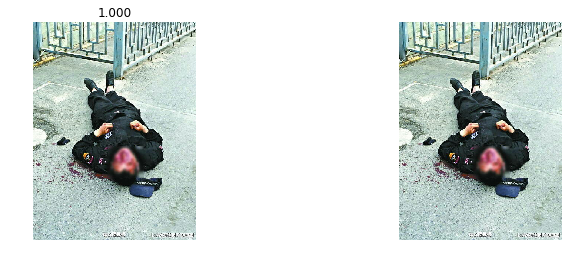

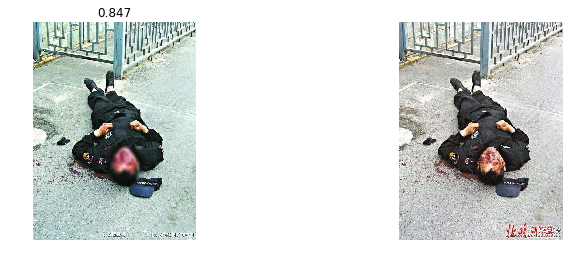

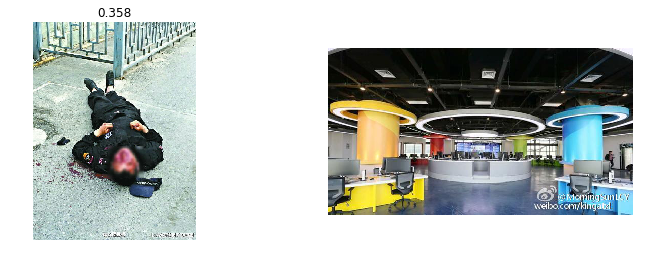

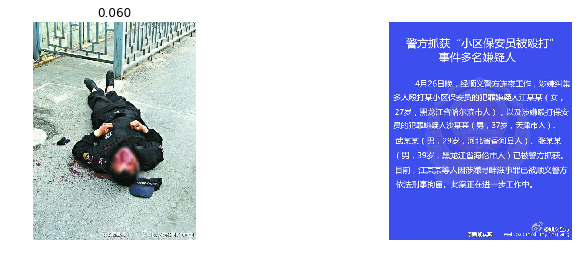

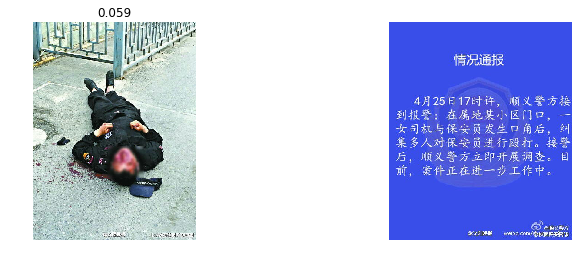

...

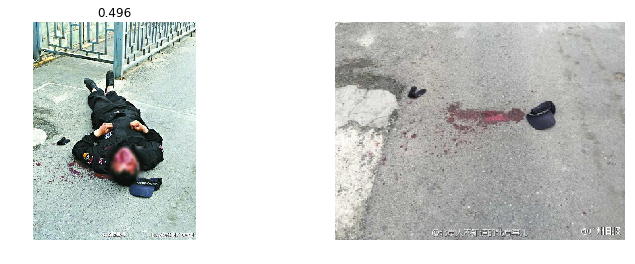

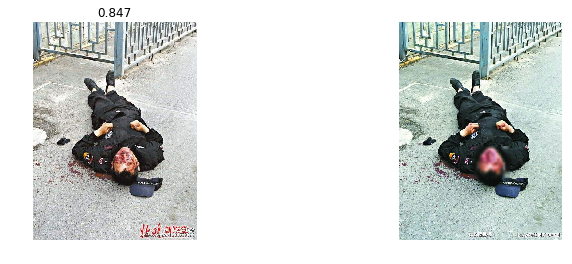

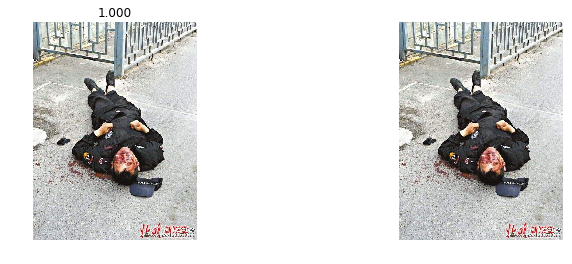

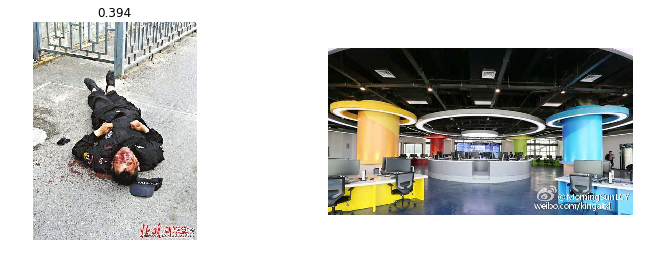

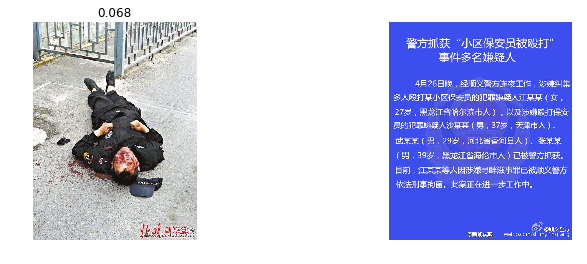

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


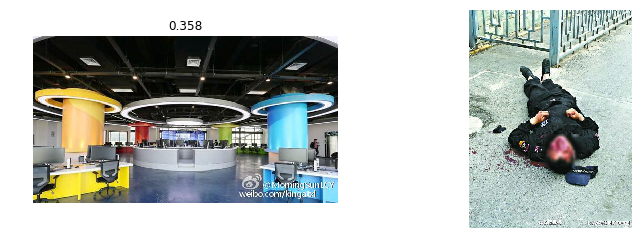

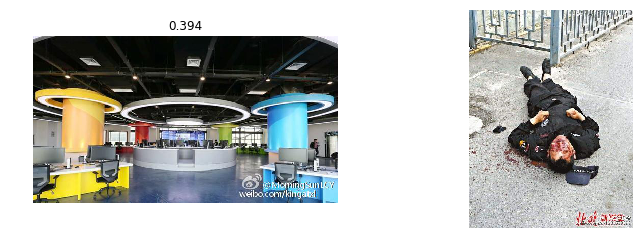

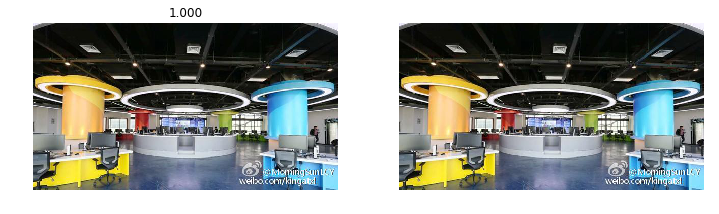

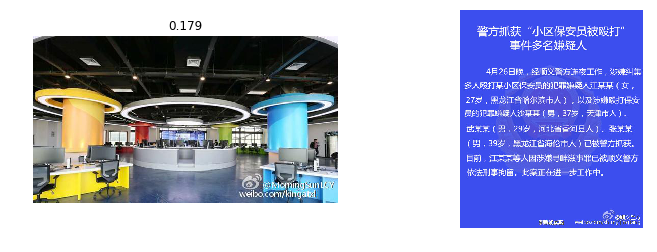

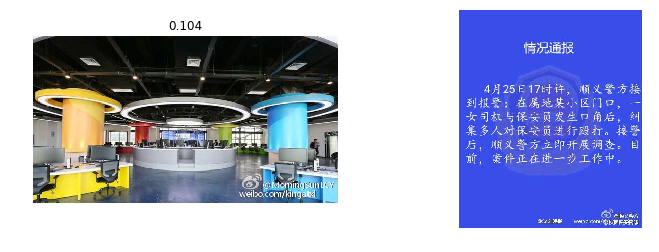

...

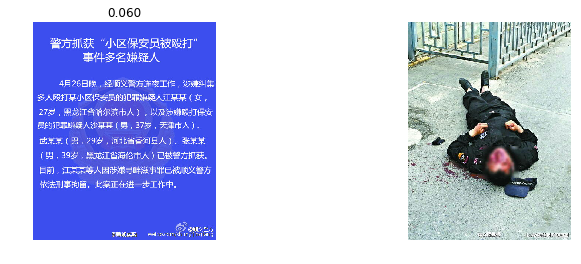

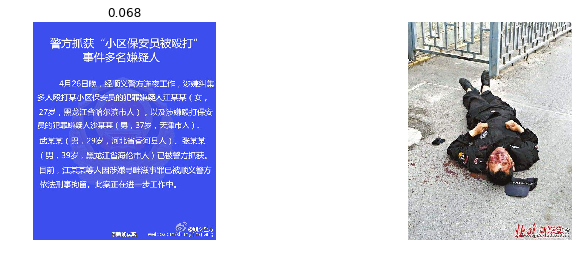

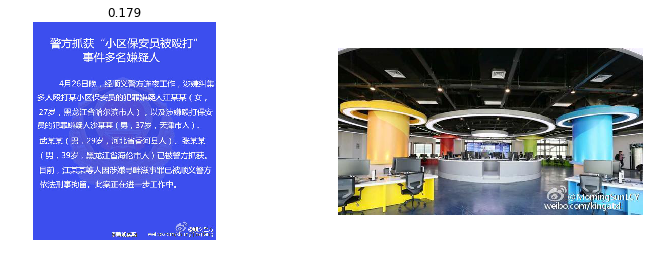

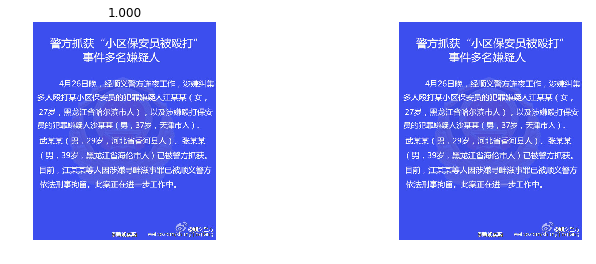

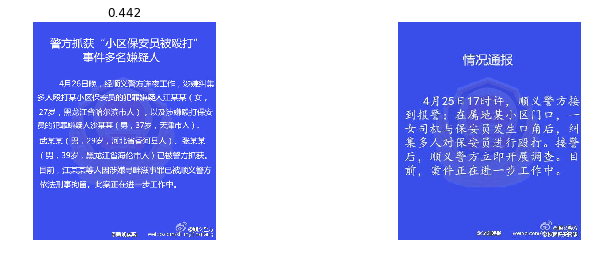

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


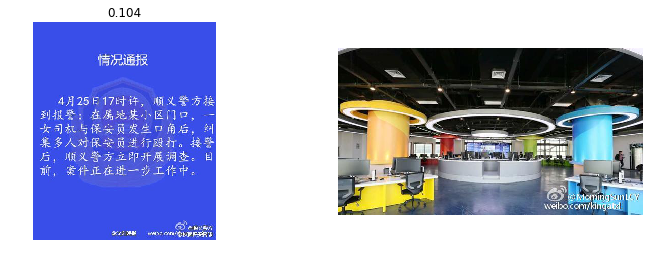

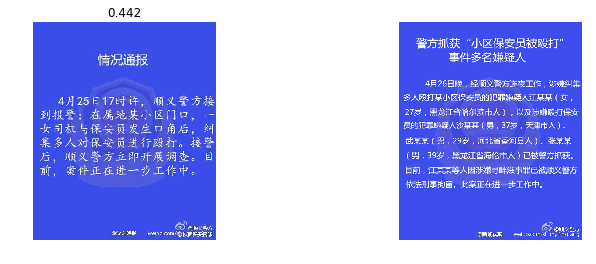

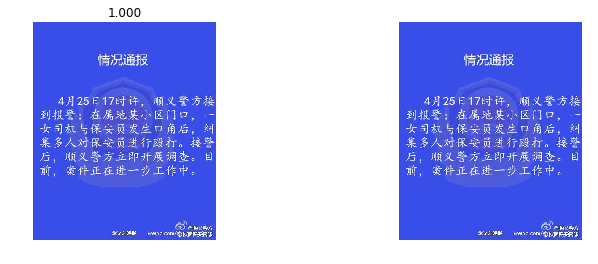

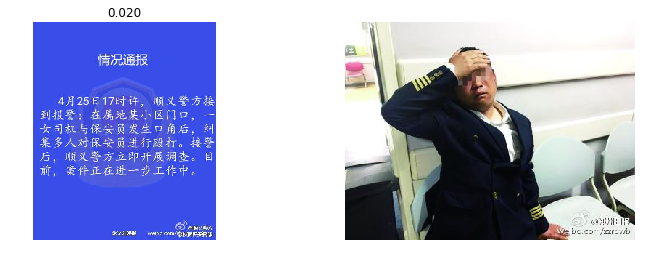

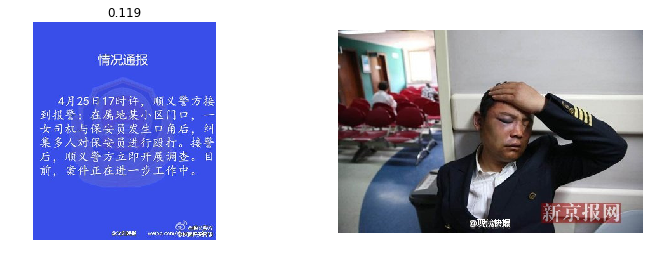

...

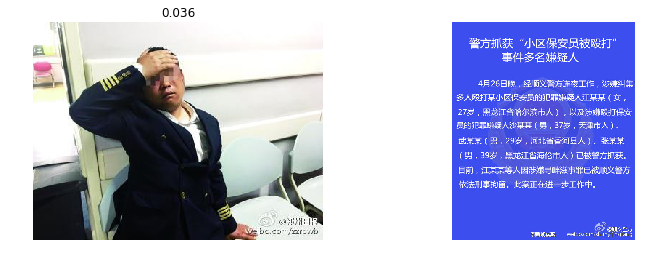

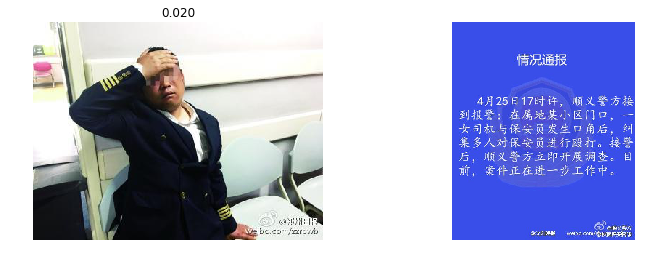

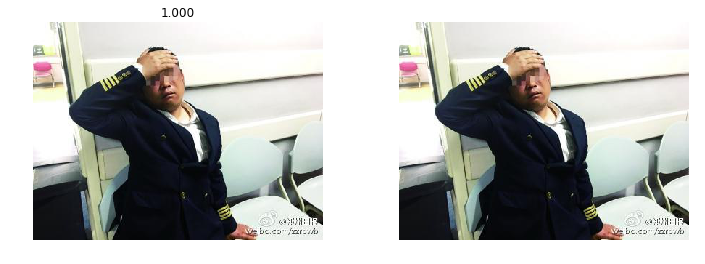

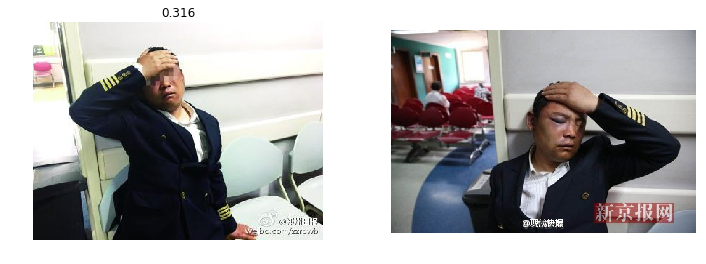

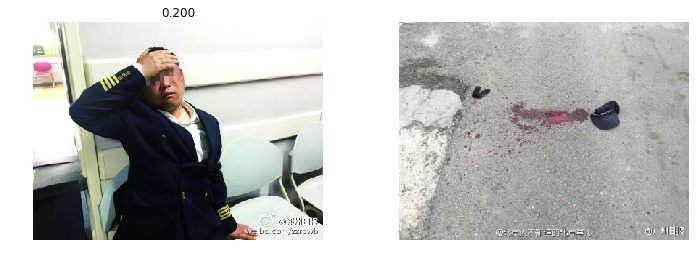

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


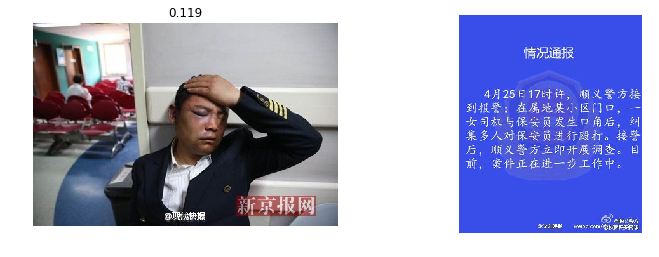

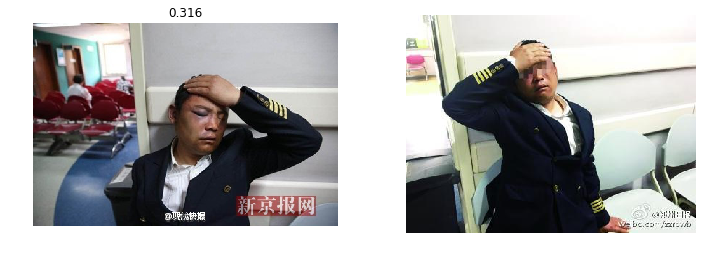

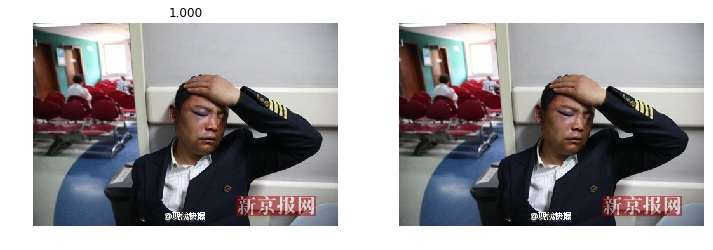

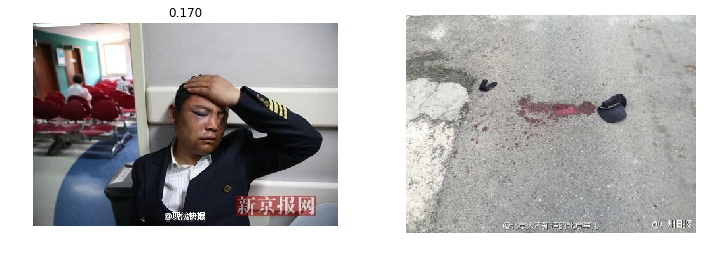

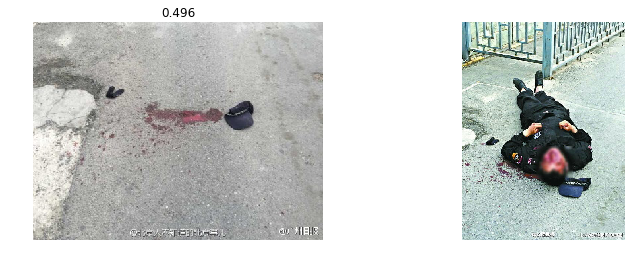

...

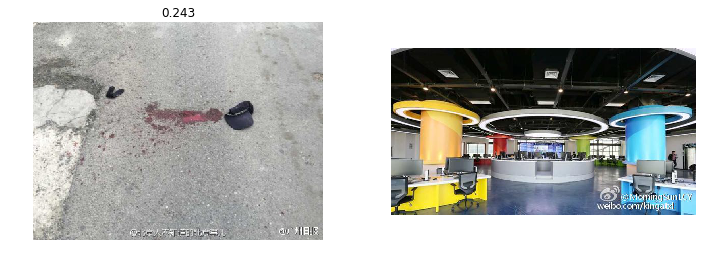

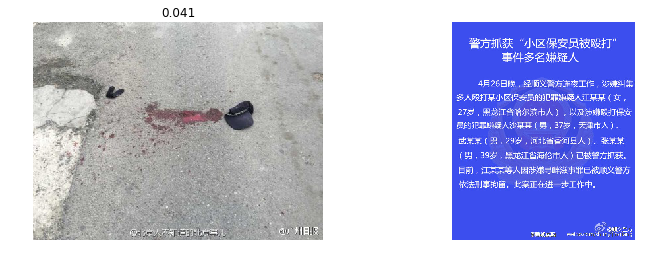

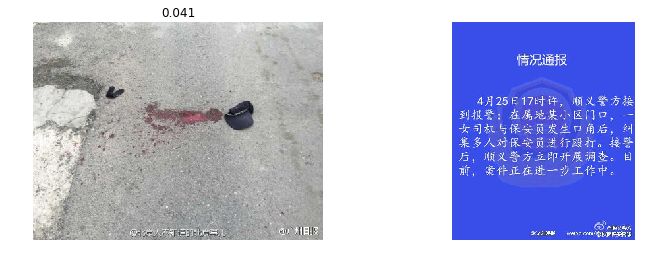

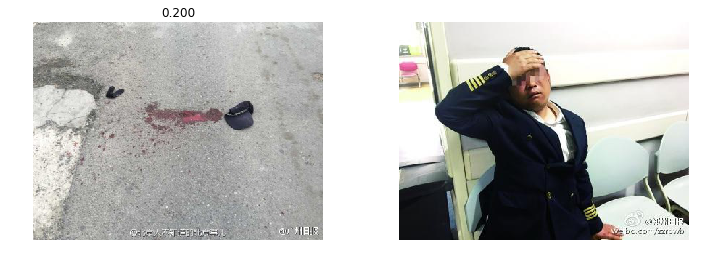

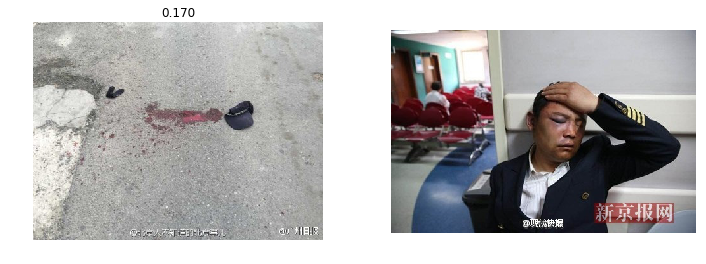

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


In [74]:
# /D5BC29F8B211769AE7E036F83A0C74E01462102720442

images = ['0-4c582bffjw1f3b42pv00gj20c80gbdhs.jpg']
images.append('0-4c81799fjw1f3af72fzw6j20ci0godhl.jpg')
images.append('0-4fa7ff80jw1f3a9tlxh9gj20go095aat.jpg')
images.append('0-4e5b54d8gw1f3bkept7whj20dz0gon07.jpg')
images.append('0-4c582bffjw1f3b433lvghj20b40d80tf.jpg')
images.append('0-a1ebed3bjw1f3bel2p51wj20b408c3yn.jpg')
images.append('0-62bfcf76gw1f3ad8osxkij20dc08wzkz.jpg')
images.append('0-70856785gw1f3ad9k5drtj20c8096gmq.jpg')

# show_images('D5BC29F8B211769AE7E036F83A0C74E01462102720442', images, 2, 4)
see_how_to_tune_threshold('D5BC29F8B211769AE7E036F83A0C74E01462102720442', images)

10


/Users/snow/anaconda2/envs/python35/lib/python3.5/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


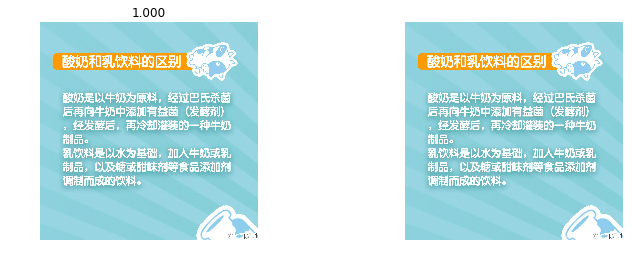

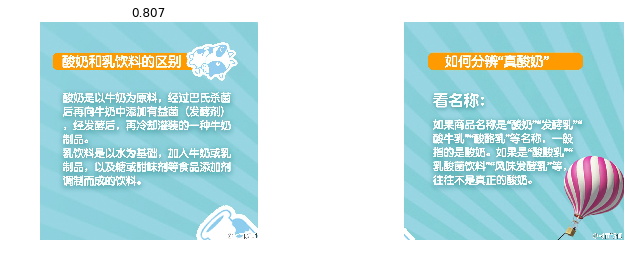

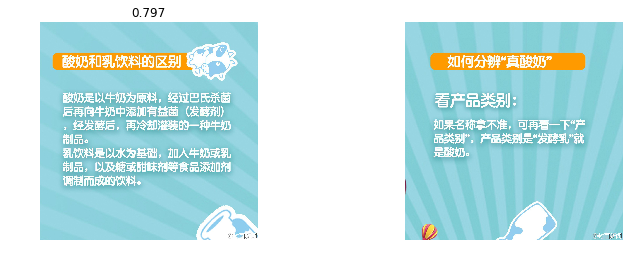

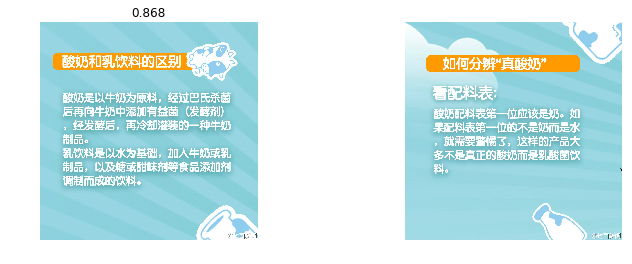

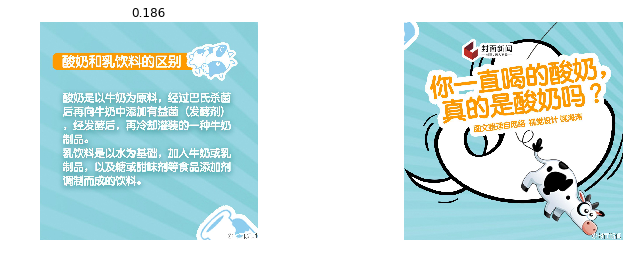

...

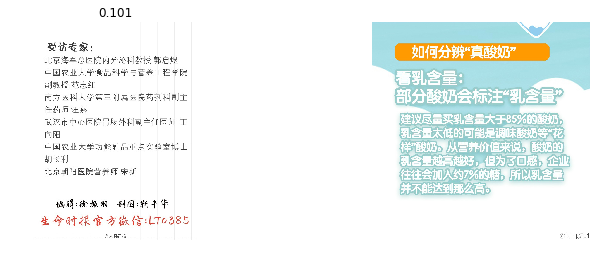

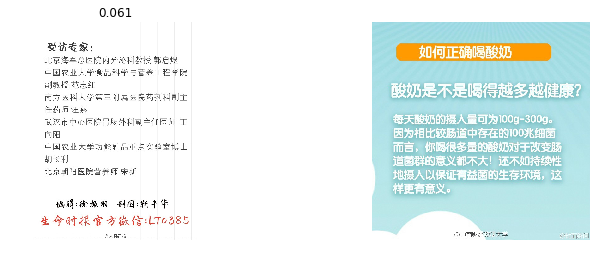

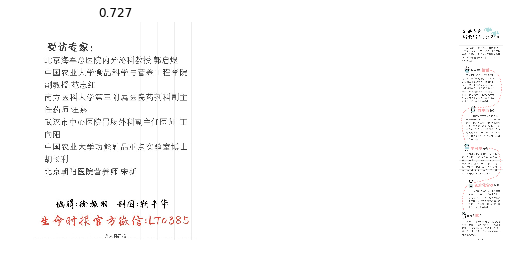

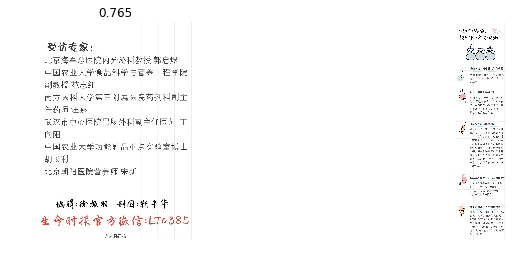

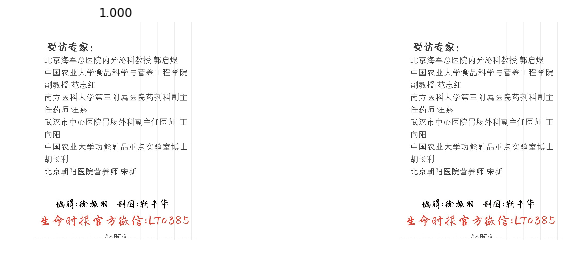

In [79]:
# /9D28A3577411682499450EB5DCC4F8111475151757776

images = ['0-006et2kRgw1f83mvsd8taj30wt0ws443.jpg']
images.append('0-006et2kRgw1f83mvt3rxcj30x50wswjp.jpg')
images.append('0-006et2kRgw1f83mvtiacbj30ws0wsq6u.jpg')
images.append('0-006et2kRgw1f83mvui065j30wt0wx78u.jpg')
images.append('0-006et2kRgw1f83mvva476j30x50wx0yd.jpg')
images.append('0-006et2kRgw1f83mvx50uaj30wt0ws0y7.jpg')
images.append('0-488877fcgw1f84abpqz83j20j60j6di3.jpg')
images.append('0-a716fd45jw1f6tbuu39jrj20ht2h3tnk.jpg')
images.append('0-a716fd45jw1f6tbuu77avj20hs269n95.jpg')
images.append('0-a716fd45jw1f6tbuu6px7j20ht0nhjut.jpg')

print(len(images))

# show_images('9D28A3577411682499450EB5DCC4F8111475151757776', images, 2, 5)
see_how_to_tune_threshold('9D28A3577411682499450EB5DCC4F8111475151757776', images)

12


/Users/snow/anaconda2/envs/python35/lib/python3.5/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


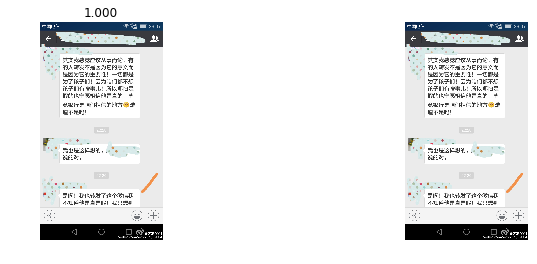

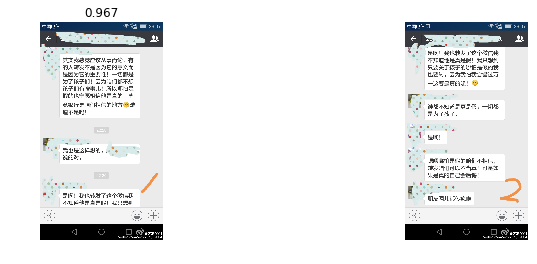

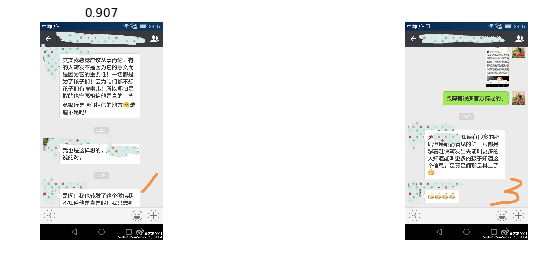

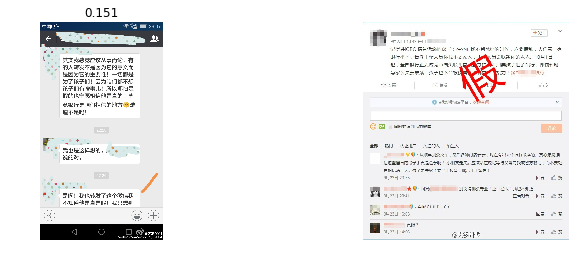

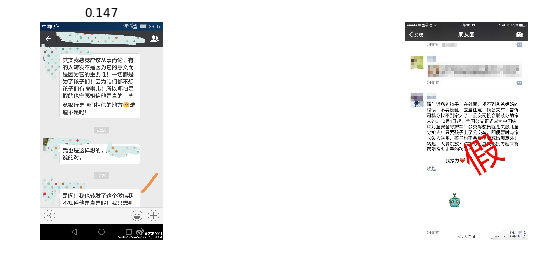

...

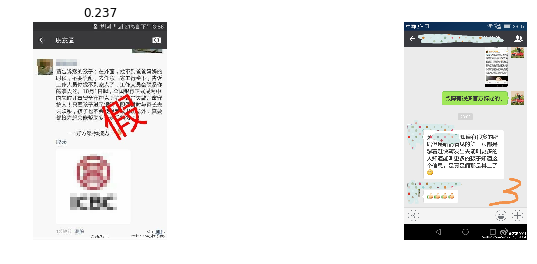

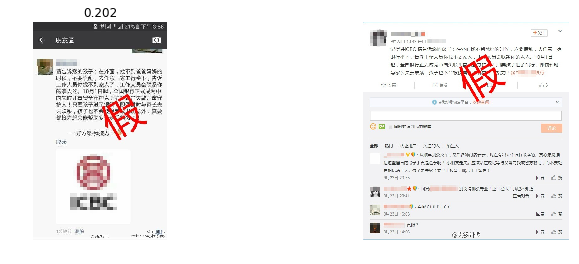

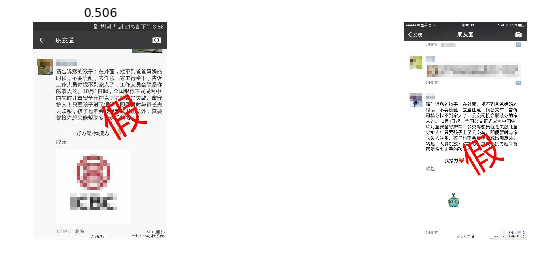

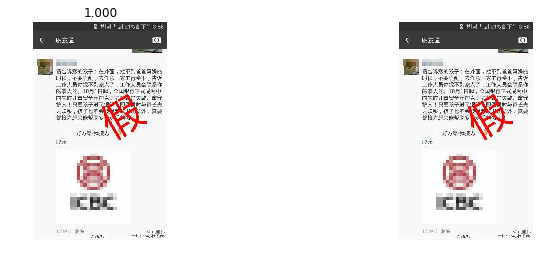

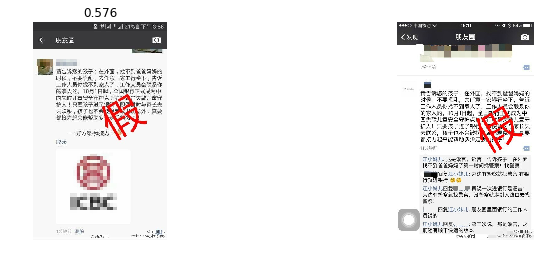

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


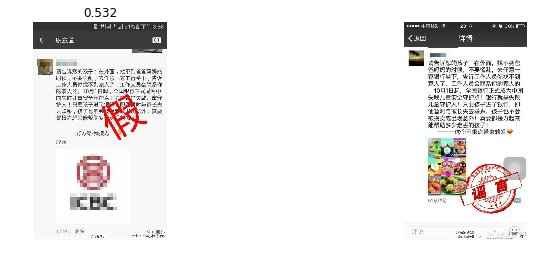

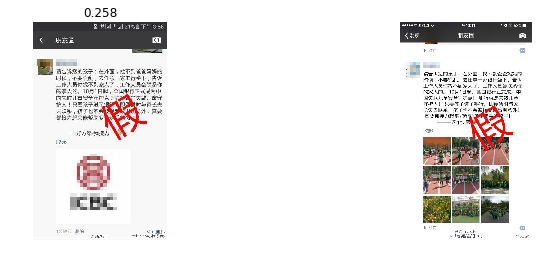

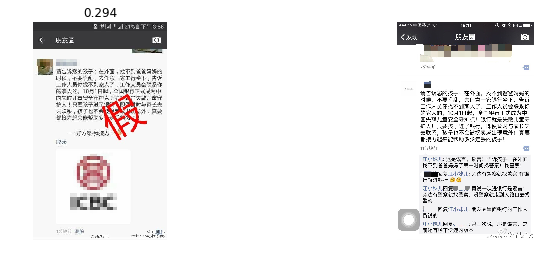

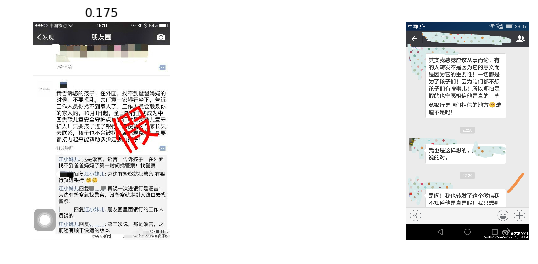

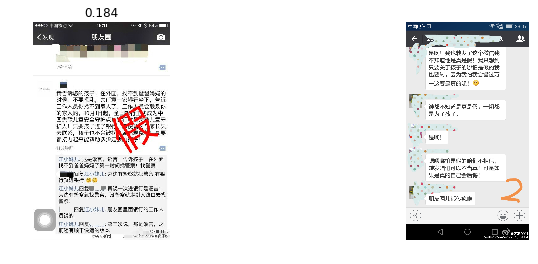

...

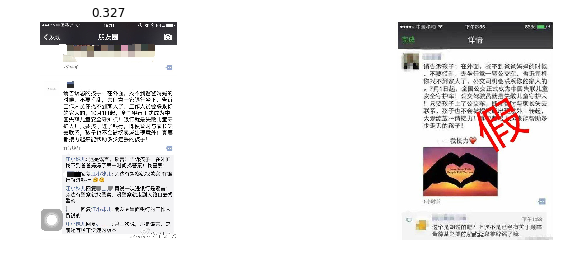

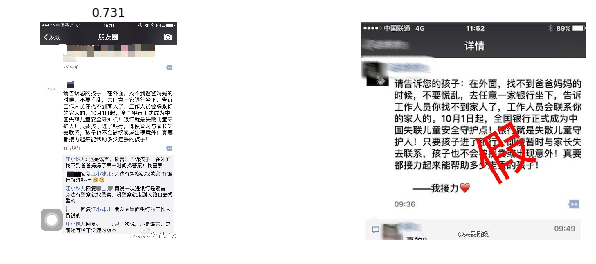

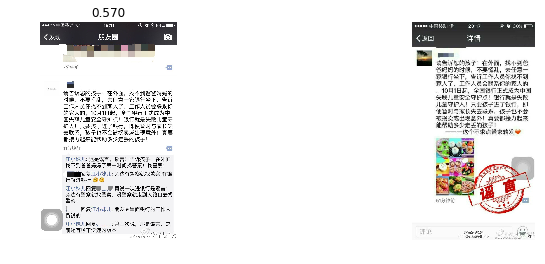

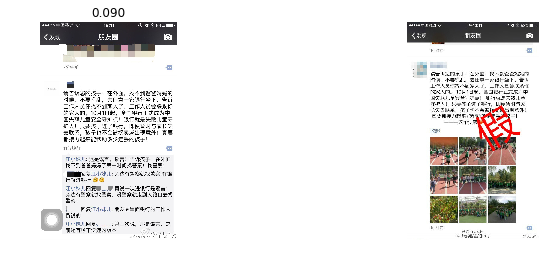

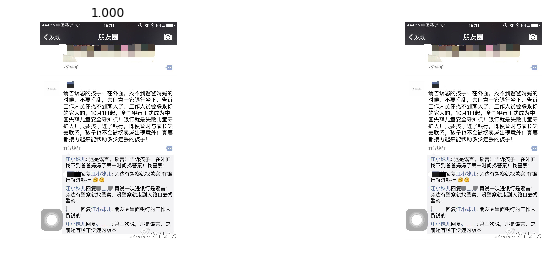

In [83]:
# /C54C036D3E6D32CE6B3130BA6374A0DB1474855155064

images = ['0-4b8a01b7jw1f852ynutdwj20qo1ben4b.jpg']
images.append('0-4b8a01b7jw1f852yolr48j20qo1be102.jpg')
images.append('0-4b8a01b7jw1f852ypniadj20qo1bewlj.jpg')
images.append('0-0065vuEVgw1f85mjvfjjyj30ib0jcad1.jpg')
images.append('0-66b630bfgw1f85r4ksgyaj20c80lq0uh.jpg')
images.append('0-66b630bfgw1f85r4l2mhhj20c80juq4i.jpg')
images.append('0-66b630bfgw1f85r4lkde1j20c80jfq5f.jpg')
images.append('0-0068adaZgw1f85mj6l35mj30c80gwq56.jpg')
images.append('0-0068clRcgw1f85mj6ak55j30fa0esq5a.jpg')
images.append('0-80e5c22ejw1f85xjbe6e4j20c80lpq5l.jpg')
images.append('0-80e5c22ejw1f85xjbxo10j20c80k60vb.jpg')
images.append('0-78221efbgw1f83qv9rrppj20ku0x40yn.jpg')

print(len(images))

# show_images('C54C036D3E6D32CE6B3130BA6374A0DB1474855155064', images, 3, 4)
see_how_to_tune_threshold('C54C036D3E6D32CE6B3130BA6374A0DB1474855155064', images)